<a href="https://colab.research.google.com/github/kavansingh582/CSCI164/blob/main/Photo_Captioning_Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Downloading...
From: https://drive.google.com/uc?id=1b47sxG6Z7W8JiubMKSN38W30cbRzbTAN
To: /content/image1.jpg
100% 1.80M/1.80M [00:00<00:00, 136MB/s]
Downloading...
From: https://drive.google.com/uc?id=17MwA0uk4T8k9-z3fC43Qvibmxv5-EwNK
To: /content/image2.jpg
100% 3.74M/3.74M [00:00<00:00, 176MB/s]
Downloading...
From: https://drive.google.com/uc?id=1K-UIDdqQE62hFYe9HQWNWaHG1K30tJ7K
To: /content/image3.jpg
100% 3.94M/3.94M [00:00<00:00, 175MB/s]


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]


Results for image1.jpg:


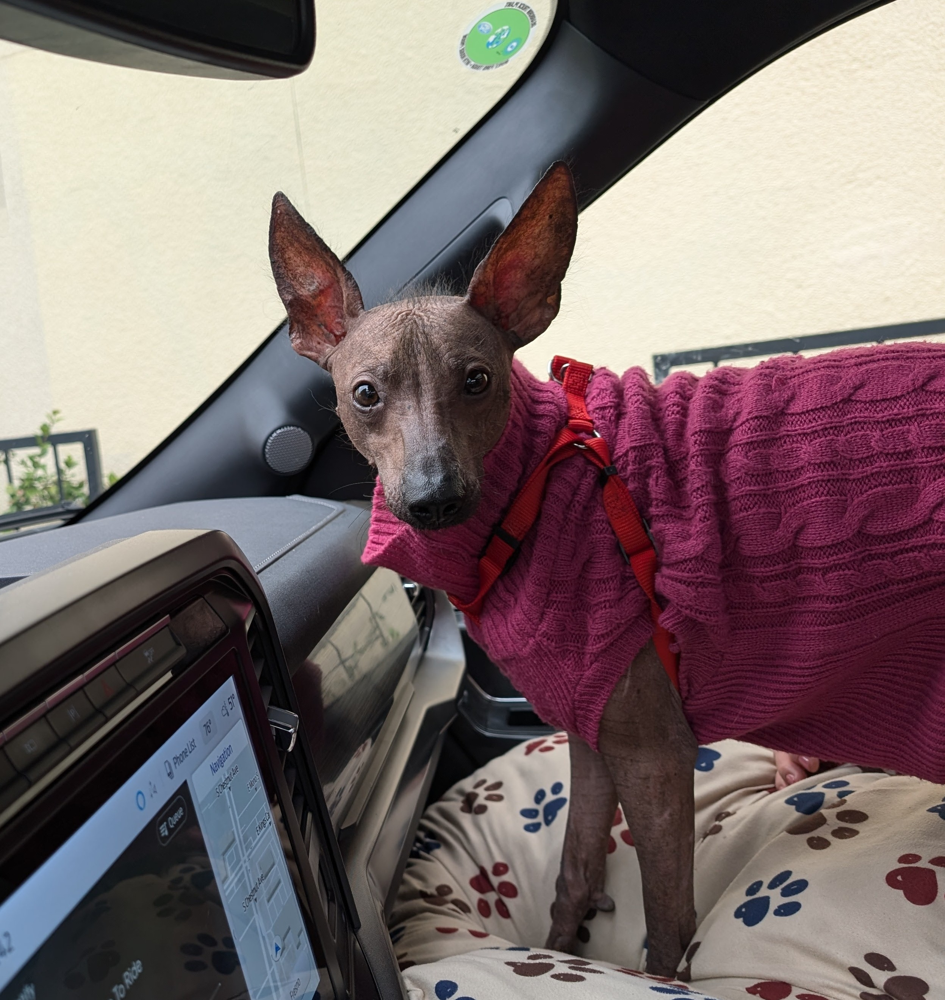

Vit-GPT2: a small dog is sitting in a car seat 


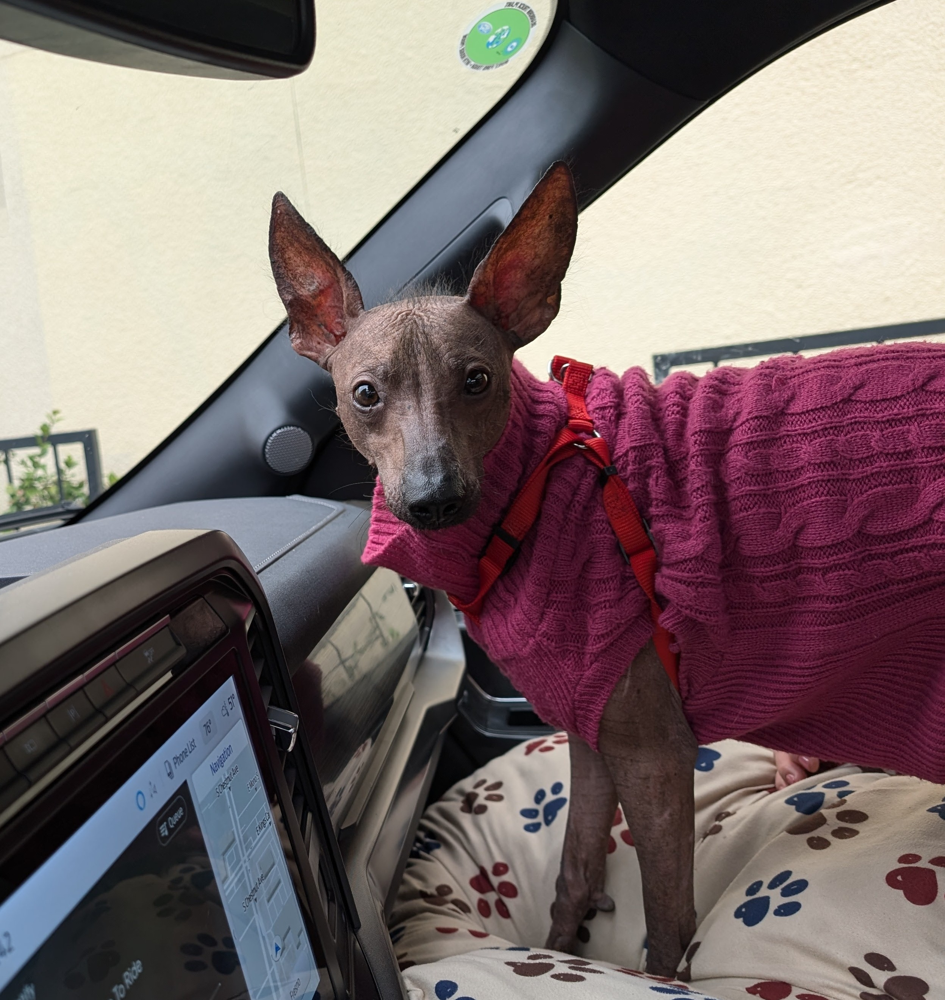

BLIP: a small dog wearing a sweater in a car


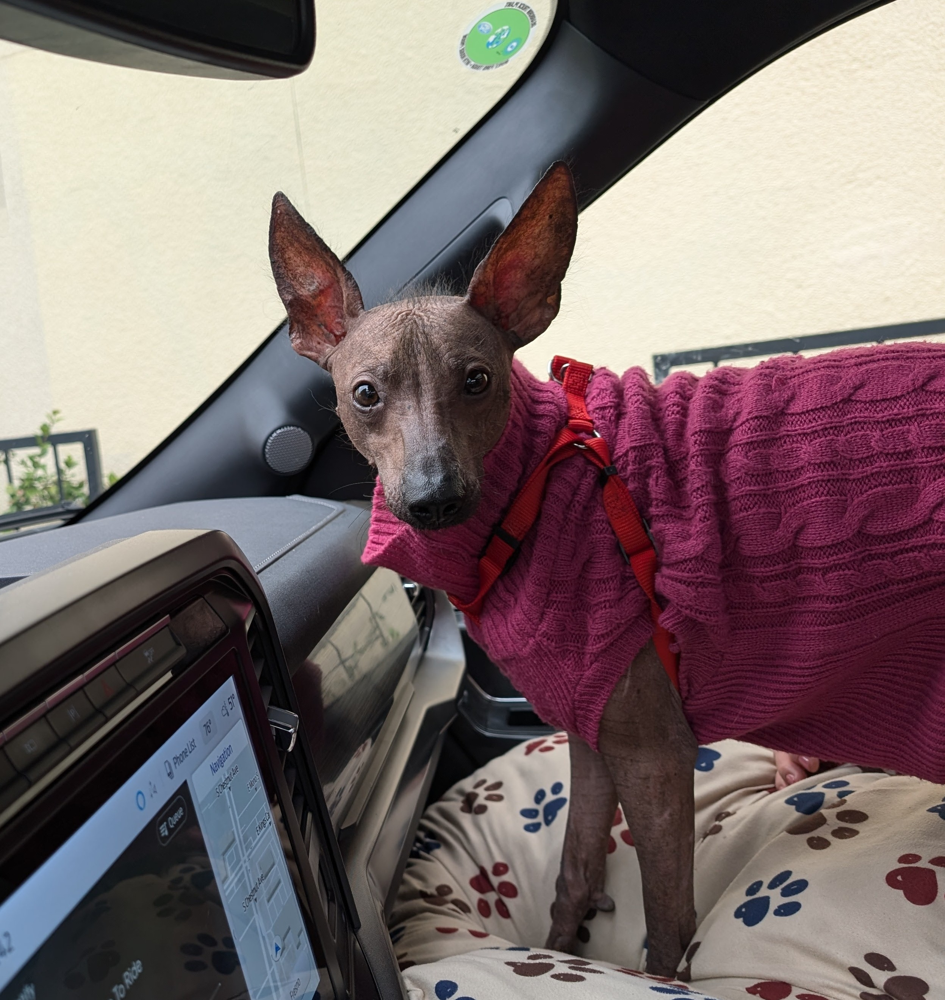

BLIP2: a dog wearing a sweater in a car


Results for image2.jpg:


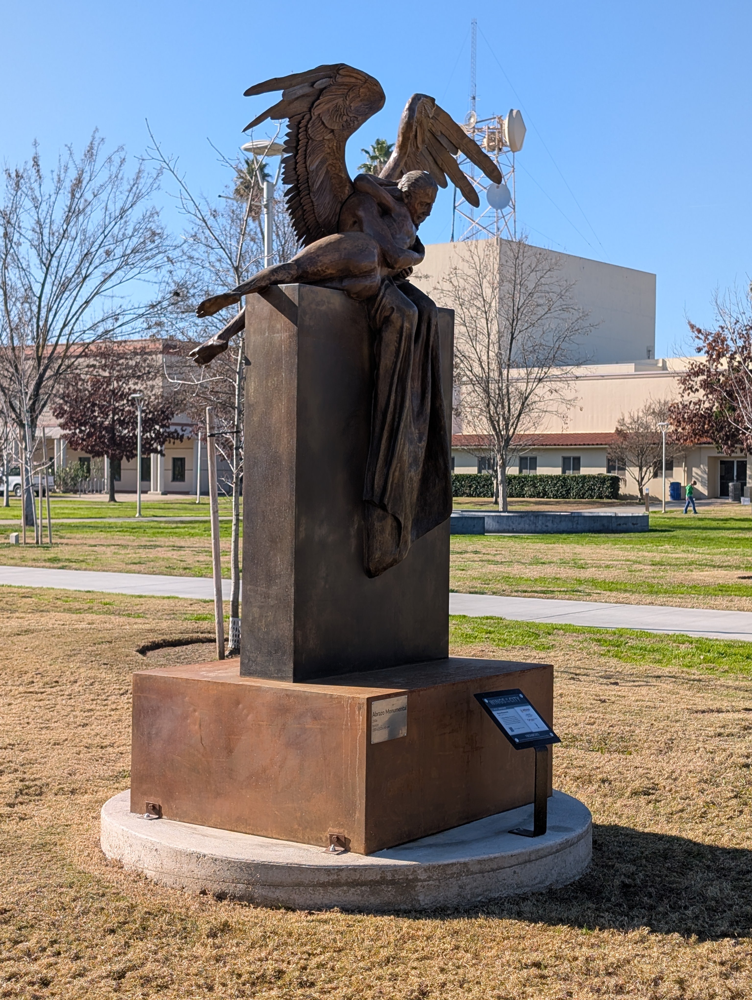

Vit-GPT2: a statue of a man on top of a horse statue 


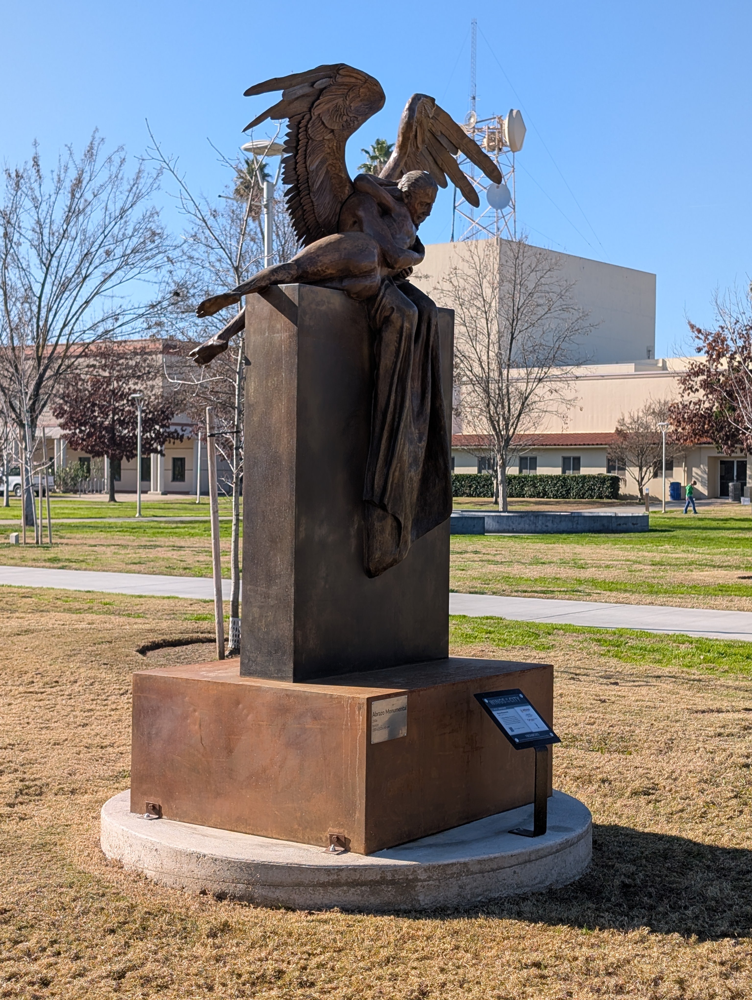

BLIP: a statue of a woman holding a bird


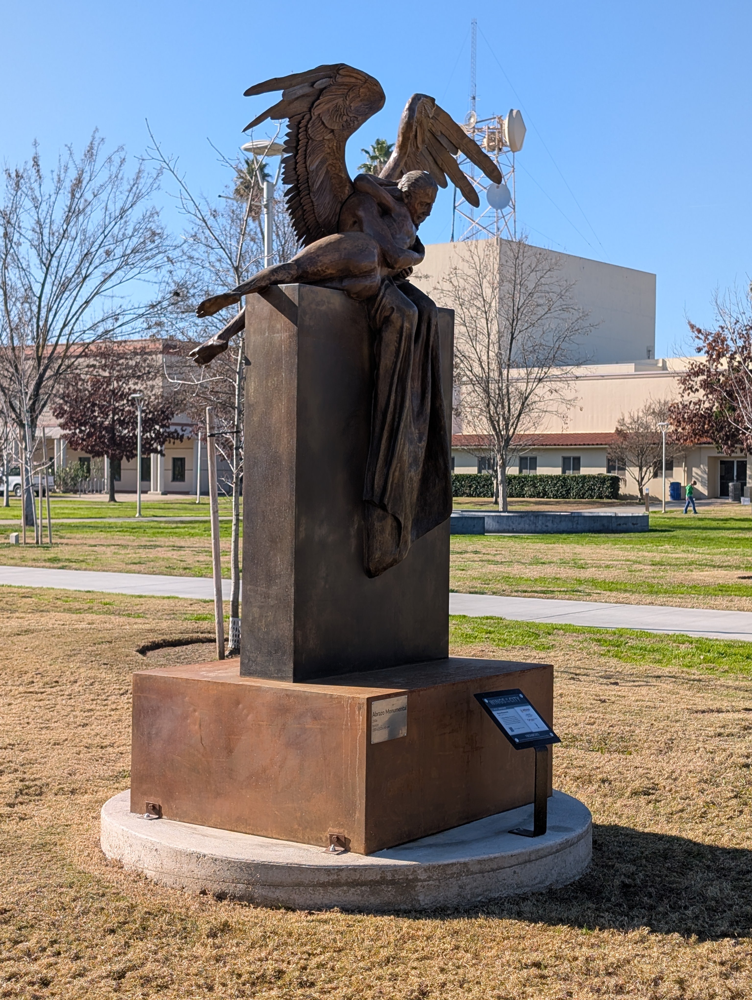

BLIP2: a statue of a woman on a pedestal in a park


Results for image3.jpg:


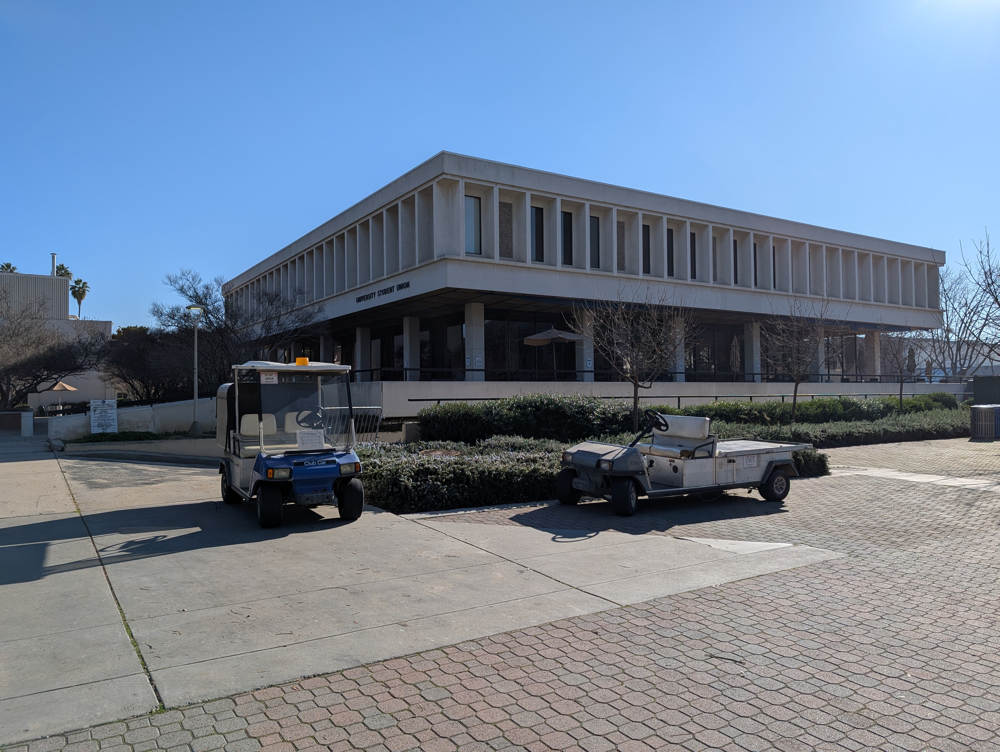

Vit-GPT2: a large white truck parked in front of a building 


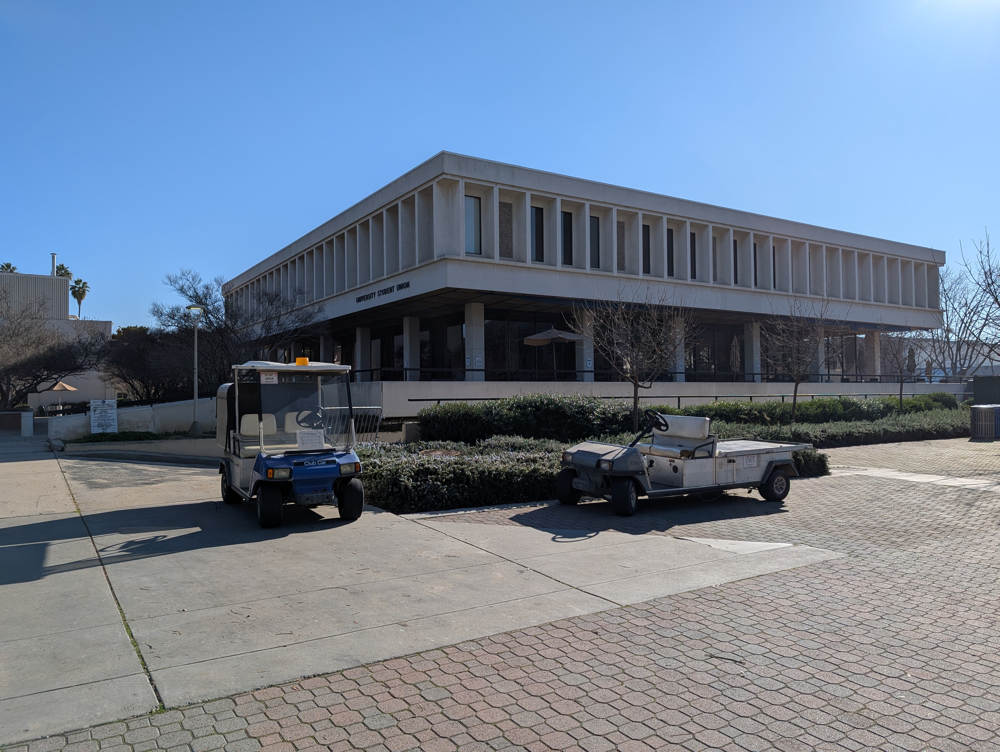

BLIP: a golf cart parked in front of a building


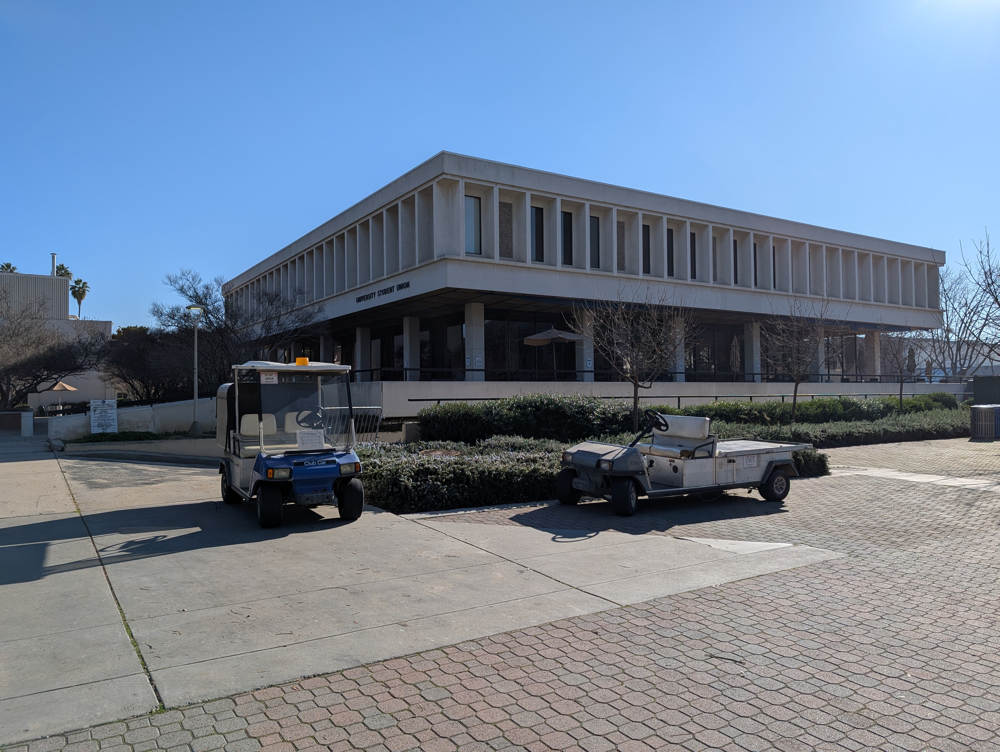

BLIP2: a blue sky with no clouds


Summary of results:

image1.jpg:
Vit-GPT2: a small dog is sitting in a car seat 
BLIP: a small dog wearing a sweater in a car
BLIP2: a dog wearing a sweater in a car


image2.jpg:
Vit-GPT2: a statue of a man on top of a horse statue 
BLIP: a statue of a woman holding a bird
BLIP2: a statue of a woman on a pedestal in a park


image3.jpg:
Vit-GPT2: a large white truck parked in front of a building 
BLIP: a golf cart parked in front of a building
BLIP2: a blue sky with no clouds



In [3]:
import warnings
warnings.filterwarnings(action='ignore')

from transformers import pipeline
from transformers.utils import logging
logging.set_verbosity(40)

from IPython.display import Image, display
import os

# Download images
!gdown 1b47sxG6Z7W8JiubMKSN38W30cbRzbTAN -O image1.jpg
!gdown 17MwA0uk4T8k9-z3fC43Qvibmxv5-EwNK -O image2.jpg
!gdown 1K-UIDdqQE62hFYe9HQWNWaHG1K30tJ7K -O image3.jpg

# File names
images = ["image1.jpg", "image2.jpg", "image3.jpg"]

# Load different captioning models
captioner1 = pipeline("image-to-text", model="nlpconnect/vit-gpt2-image-captioning")
captioner2 = pipeline("image-to-text", model="Salesforce/blip-image-captioning-base")
captioner3 = pipeline("image-to-text", model="Salesforce/blip2-opt-2.7b")

# Function to generate captions
def generate_captions(image, captioner, model_name):
    display(Image(filename=image))
    caption = captioner(image)
    print(f"{model_name}: {caption[0]['generated_text']}")
    return caption[0]['generated_text']

# Generate captions for each image using all models
results = {}
for img in images:
    print(f"\nResults for {img}:")
    results[img] = {
        "Vit-GPT2": generate_captions(img, captioner1, "Vit-GPT2"),
        "BLIP": generate_captions(img, captioner2, "BLIP"),
        "BLIP2": generate_captions(img, captioner3, "BLIP2")
    }

# Summary of results
print("\nSummary of results:")
for img, captions in results.items():
    print(f"\n{img}:")
    for model, caption in captions.items():
        print(f"{model}: {caption}")
